<a href="https://colab.research.google.com/github/BlancaVisca/Extraccion_de_Caracteristicas/blob/main/Copehnague/copehnague.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#Instalamos librería para análisis de variables categóricas
%pip install funpymodeling

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.6/204.6 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 325.3/325.3 kB 22.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.3/293.3 kB 21.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 60.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 85.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.2/117.2 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 469.0/469.0 kB 30.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.1/69.1 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 385.8/385.8 kB 22.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from funpymodeling.exploratory import freq_tbl

In [4]:
#Cargar archivo csv desde equipo
from google.colab import files
files.upload()

Saving Datos_limpios.csv to Datos_limpios (1).csv


{'Datos_limpios (1).csv': b',last_scraped,name,description,neighborhood_overview,host_location,host_response_time,host_is_superhost,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,property_type,room_type,bathrooms_text,amenities,price,has_availability,last_review,instant_bookable,host_response_rate,host_acceptance_rate,latitude,longitude,accommodates,bathrooms,bedrooms,beds,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month\r\n0,2024-09-28,Art&Design apt in hip N\xc3\xb8rrebro - 2BR,"Bright, cozy, and well-furnished 3rd floor designer apartment in N\xc3\xb8rrebr

In [5]:
#Carga desde un archivo .xlsx sin indice
df=pd.read_csv('Datos_limpios.csv')

In [6]:
#Verificamos la informacion del dataframe
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21528 entries, 0 to 21527
Data columns (total 50 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Unnamed: 0                   21528 non-null  int64  
 1   last_scraped                 21528 non-null  object 
 2   name                         21528 non-null  object 
 3   description                  21528 non-null  object 
 4   neighborhood_overview        21528 non-null  object 
 5   host_location                21528 non-null  object 
 6   host_response_time           21528 non-null  object 
 7   host_is_superhost            21528 non-null  object 
 8   host_verifications           21528 non-null  object 
 9   host_has_profile_pic         21528 non-null  object 
 10  host_identity_verified       21528 non-null  object 
 11  neighbourhood                21528 non-null  object 
 12  property_type                21528 non-null  object 
 13  room_type       

In [7]:
#Imprimo los primeros 5 registros del Dataframe
df.head()

,Unnamed: 0,last_scraped,name,description,neighborhood_overview,host_location,host_response_time,host_is_superhost,host_verifications,host_has_profile_pic,...,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
0,0,2024-09-28,Art&Design apt in hip Nørrebro - 2BR,"Bright, cozy, and well-furnished 3rd floor des...",The apartment is located in trendy Nørrebro wi...,"Copenhagen, Denmark",within an hour,f,"['email', 'phone']",t,...,9.9,3.0,0.0,4.90,4.92,4.91,4.95,4.90,4.79,0.66
1,1,2024-09-28,"Beautiful, spacious, central, renovated Penthouse","Welcome to our home, we hope you will enjoy Wo...","What else is nearby?<br />To be honest, We thi...","Copenhagen, Denmark",a few days or more,f,"['email', 'phone']",t,...,19.0,0.0,0.0,4.88,4.88,4.87,4.82,4.80,4.53,0.11
2,2,2024-09-28,"155 m2 artist flat on Vesterbro, with 2 bathrooms",You enter a narrow entrance and feel the good ...,"Værnedamsvej area is super hip area, we call i...","Copenhagen, Denmark",within a few hours,t,"['email', 'phone']",t,...,9.9,2.0,0.0,4.91,4.93,4.89,4.91,4.89,4.71,0.48
3,3,2024-09-28,Cozy flat for Adults/Quiet for kids,Our flat is placed in a Central AND Quiet neig...,no neighborhood overview,"Copenhagen, Denmark",a few days or more,f,"['email', 'phone']",t,...,7.0,0.0,0.0,4.57,4.50,5.00,5.00,4.50,4.50,0.04
4,4,2024-09-28,0 min. from everything in Cph.,It doesn't get more central than this. Histori...,Area: <br />This is the eye of Cph. right betw...,"Copenhagen, Denmark",within an hour,t,"['email', 'phone']",t,...,34.0,10.0,2.0,4.94,4.89,4.82,5.00,4.93,4.89,0.20


In [8]:
freq_tbl(df)

  last_scraped  frequency  percentage  cumulative_perc
0   2024-09-28      21527    0.999954         0.999954
1   2024-09-30          1    0.000046         1.000000

----------------------------------------------------------------

                                                   name  frequency  \
0                                 Lejlighed i København         64   
1                        Hyggelig lejlighed på Nørrebro         56   
2                          Cozy apartment in Copenhagen         42   
3                        Hyggelig lejlighed på Østerbro         30   
4                            Skøn lejlighed i København         27   
...                                                 ...        ...   
19429   Hyggelig flat with balcony nearby Amagerbro st.          1   
19430       Top Luxury "The Silo" flat! Family friendly          1   
19431      Spacious, homey flat 100m from metro station          1   
19432  Penthouse - København S ( Bellacenter Congress )          1  

In [12]:
table= freq_tbl(df['host_response_rate'])
table

,host_response_rate,frequency,percentage,cumulative_perc
0,100.0,10766,0.500093,0.500093
1,90.0,7852,0.364734,0.864827
2,0.0,431,0.020020,0.884848
3,80.0,329,0.015282,0.900130
4,50.0,291,0.013517,0.913647
...,...,...,...,...
75,39.0,1,0.000046,0.999814
76,4.0,1,0.000046,0.999861
77,46.0,1,0.000046,0.999907
78,79.0,1,0.000046,0.999954


In [11]:
df['host_response_rate'] = df['host_response_rate'].astype('category')

In [45]:
table= table.drop(['percentage','cumulative_perc'], axis=1)
table

,host_response_rate,frequency
0,100.0,10766
1,90.0,7852
2,0.0,431
3,80.0,329
4,50.0,291
...,...,...
75,39.0,1
76,4.0,1
77,46.0,1
78,79.0,1


In [52]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table = table[table['frequency']>300]
table

,frequency
host_response_rate,
100.0,10766
90.0,7852
0.0,431
80.0,329


<Axes: ylabel='frequency'>

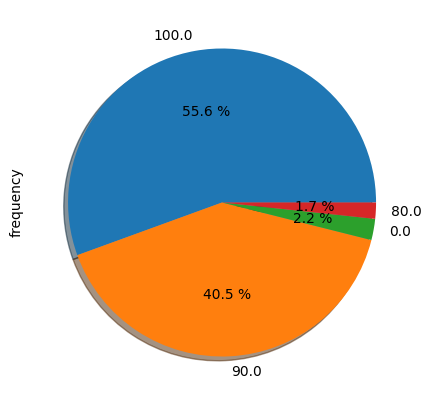

In [55]:
#Realizamos grafico de pastel
table["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [13]:
df['host_acceptance_rate'] = df['host_acceptance_rate'].astype('category')

In [14]:
table1= freq_tbl(df['host_acceptance_rate'])
table1

,host_acceptance_rate,frequency,percentage,cumulative_perc
0,67.0,4954,0.230119,0.230119
1,100.0,4749,0.220596,0.450715
2,0.0,1245,0.057832,0.508547
3,50.0,878,0.040784,0.549331
4,75.0,460,0.021368,0.570699
...,...,...,...,...
96,34.0,14,0.000650,0.998560
97,66.0,13,0.000604,0.999164
98,49.0,11,0.000511,0.999675
99,2.0,5,0.000232,0.999907


In [56]:
table1= table1.drop(['percentage','cumulative_perc'], axis=1)
table1

,host_acceptance_rate,frequency
0,67.0,4954
1,100.0,4749
2,0.0,1245
3,50.0,878
4,75.0,460
...,...,...
96,34.0,14
97,66.0,13
98,49.0,11
99,2.0,5


In [60]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table1 = table1[table1['frequency']>150]
table1

,host_acceptance_rate,frequency
0,67.0,4954
1,100.0,4749
2,0.0,1245
3,50.0,878
4,75.0,460
5,99.0,444
6,80.0,358
7,33.0,351
8,60.0,278
9,83.0,276


In [61]:
#Ajusto el índice de mi dataframe
table1 = table1.set_index('host_acceptance_rate')
table1

,frequency
host_acceptance_rate,
67.0,4954
100.0,4749
0.0,1245
50.0,878
75.0,460
99.0,444
80.0,358
33.0,351
60.0,278


Text(0, 0.5, 'Frecuencia')

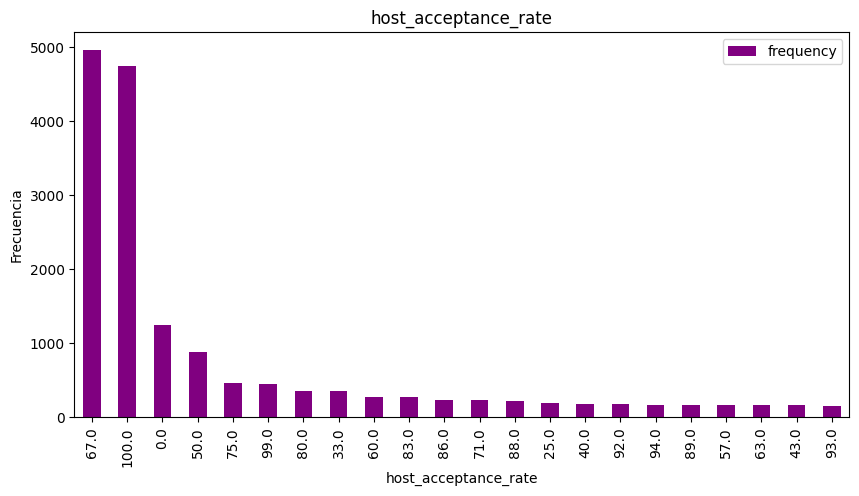

In [65]:
#Realizamos grafico de barras del dataframe filtrado
table1.plot(kind = 'bar', width=0.5, figsize=(10, 5), color="purple")
plt.title('host_acceptance_rate')
plt.ylabel('Frecuencia')

In [15]:
table2= freq_tbl(df['host_is_superhost'])
table2

,host_is_superhost,frequency,percentage,cumulative_perc
0,f,18947,0.88011,0.88011
1,t,2581,0.11989,1.00000


In [74]:
table2= table2.drop(['percentage','cumulative_perc'], axis=1)
table2

KeyError: "['percentage', 'cumulative_perc'] not found in axis"

In [75]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table2 = table2[table2['frequency']>1]
table2

,frequency
host_is_superhost,
f,18947
t,2581


In [72]:
#Ajusto el índice de mi dataframe
table2 = table2.set_index('host_is_superhost')
table2

,frequency
host_is_superhost,
f,18947
t,2581


<Axes: ylabel='frequency'>

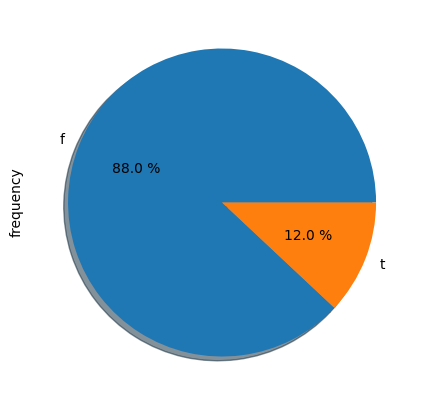

In [76]:
#Realizamos grafico de pastel
table2["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [66]:
table3= freq_tbl(df['host_verifications'])
table3

,host_verifications,frequency,percentage,cumulative_perc
0,"['email', 'phone']",17540,0.814753,0.814753
1,['phone'],2265,0.105212,0.919965
2,"['email', 'phone', 'work_email']",1634,0.075901,0.995866
3,"['phone', 'work_email']",61,0.002834,0.998699
4,['email'],13,0.000604,0.999303
5,[],8,0.000372,0.999675
6,"['email', 'work_email']",5,0.000232,0.999907
7,"['email', 'phone', 'photographer']",2,0.000093,1.000000


In [77]:
table3= table3.drop(['percentage','cumulative_perc'], axis=1)
table3

,host_verifications,frequency
0,"['email', 'phone']",17540
1,['phone'],2265
2,"['email', 'phone', 'work_email']",1634
3,"['phone', 'work_email']",61
4,['email'],13
5,[],8
6,"['email', 'work_email']",5
7,"['email', 'phone', 'photographer']",2


In [84]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table3 = table3[table3['frequency']>8]
table3

,frequency
host_verifications,
"['email', 'phone']",17540
['phone'],2265
"['email', 'phone', 'work_email']",1634
"['phone', 'work_email']",61
['email'],13


In [80]:
#Ajusto el índice de mi dataframe
table3 = table3.set_index('host_verifications')
table3

,frequency
host_verifications,
"['email', 'phone']",17540
['phone'],2265
"['email', 'phone', 'work_email']",1634
"['phone', 'work_email']",61
['email'],13
[],8
"['email', 'work_email']",5
"['email', 'phone', 'photographer']",2


<Axes: ylabel='frequency'>

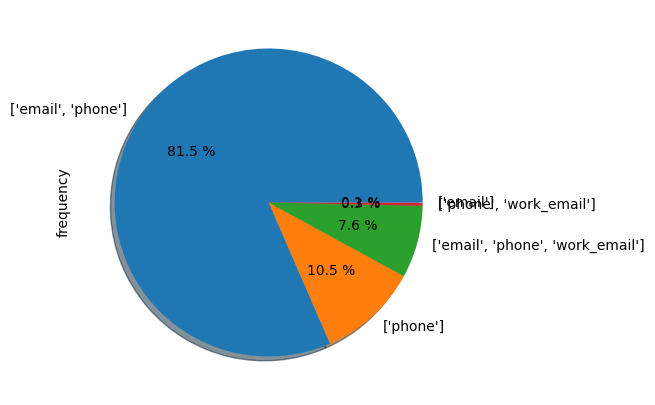

In [85]:
#Realizamos grafico de pastel
table3["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [17]:
table4= freq_tbl(df['host_identity_verified'])
table4

,host_identity_verified,frequency,percentage,cumulative_perc
0,t,19035,0.884197,0.884197
1,f,2493,0.115803,1.000000


In [87]:
table4= table4.drop(['percentage','cumulative_perc'], axis=1)
table4

,host_identity_verified,frequency
0,t,19035
1,f,2493


In [88]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table4 = table4[table4['frequency']>150]
table4

,host_identity_verified,frequency
0,t,19035
1,f,2493


In [91]:
#Ajusto el índice de mi dataframe
table4 = table4.set_index('host_identity_verified')
table4

,frequency
host_identity_verified,
t,19035
f,2493


<Axes: ylabel='frequency'>

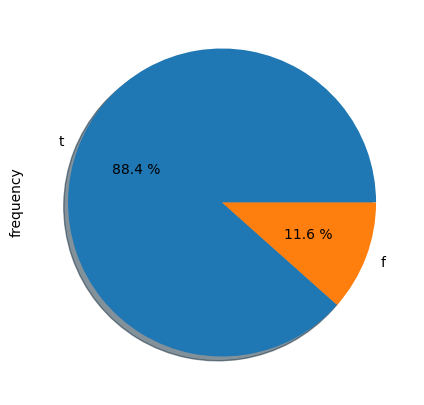

In [96]:
#Realizamos grafico de pastel
table4["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [18]:
table5= freq_tbl(df['neighbourhood'])
table5

,neighbourhood,frequency,percentage,cumulative_perc
0,Copehnague,12797,0.594435,0.594435
1,"Copenhagen, Denmark",6845,0.317958,0.912393
2,"Frederiksberg, Denmark",792,0.036789,0.949182
3,"Copenhagen, Capital Region of Denmark, Denmark",437,0.020299,0.969482
4,"Copenhagen, Hovedstaden, Denmark",66,0.003066,0.972547
...,...,...,...,...
214,"Frederiksberg, Kbh, Denmark",1,0.000046,0.999814
215,"Copenhagen, Kbh NV, Denmark",1,0.000046,0.999861
216,"Copenhagen , Danmark, Denmark",1,0.000046,0.999907
217,"København V., Denmark",1,0.000046,0.999954


In [97]:
table5= table5.drop(['percentage','cumulative_perc'], axis=1)
table5

,neighbourhood,frequency
0,Copehnague,12797
1,"Copenhagen, Denmark",6845
2,"Frederiksberg, Denmark",792
3,"Copenhagen, Capital Region of Denmark, Denmark",437
4,"Copenhagen, Hovedstaden, Denmark",66
...,...,...
214,"Frederiksberg, Kbh, Denmark",1
215,"Copenhagen, Kbh NV, Denmark",1
216,"Copenhagen , Danmark, Denmark",1
217,"København V., Denmark",1


In [100]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table5 = table5[table5['frequency']>10]
table5

,neighbourhood,frequency
0,Copehnague,12797
1,"Copenhagen, Denmark",6845
2,"Frederiksberg, Denmark",792
3,"Copenhagen, Capital Region of Denmark, Denmark",437
4,"Copenhagen, Hovedstaden, Denmark",66
5,"Frederiksberg, Capital Region of Denmark, Denmark",47
6,"Copenhagen, Danmark, Denmark",26
7,"Hellerup, Denmark",24
8,"Copenhagen, København, Denmark",24
9,"København V, Denmark",23


In [101]:
#Ajusto el índice de mi dataframe
table5 = table5.set_index('neighbourhood')
table5

,frequency
neighbourhood,
Copehnague,12797
"Copenhagen, Denmark",6845
"Frederiksberg, Denmark",792
"Copenhagen, Capital Region of Denmark, Denmark",437
"Copenhagen, Hovedstaden, Denmark",66
"Frederiksberg, Capital Region of Denmark, Denmark",47
"Copenhagen, Danmark, Denmark",26
"Hellerup, Denmark",24
"Copenhagen, København, Denmark",24


Text(0, 0.5, 'Frecuencia')

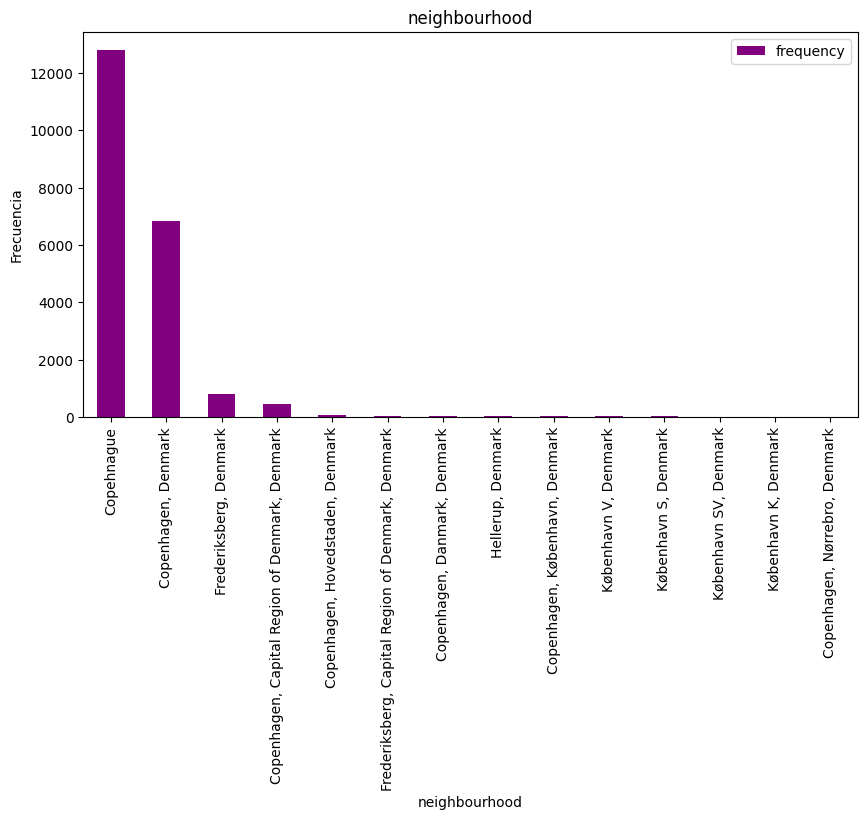

In [102]:
#Realizamos grafico de barras del dataframe filtrado
table5.plot(kind = 'bar', width=0.5, figsize=(10, 5), color="purple")
plt.title('neighbourhood')
plt.ylabel('Frecuencia')


In [20]:
table7= freq_tbl(df['property_type'])
table7

,property_type,frequency,percentage,cumulative_perc
0,Entire rental unit,12199,0.566657,0.566657
1,Entire condo,5445,0.252926,0.819584
2,Private room in rental unit,1128,0.052397,0.871981
3,Entire home,1026,0.047659,0.919640
4,Private room in condo,400,0.018580,0.938220
5,Entire townhouse,372,0.017280,0.955500
6,Entire villa,183,0.008501,0.964000
7,Entire serviced apartment,148,0.006875,0.970875
8,Private room in home,136,0.006317,0.977192
9,Entire loft,126,0.005853,0.983045


In [104]:
table7= table7.drop(['percentage','cumulative_perc'], axis=1)
table7

,property_type,frequency
0,Entire rental unit,12199
1,Entire condo,5445
2,Private room in rental unit,1128
3,Entire home,1026
4,Private room in condo,400
5,Entire townhouse,372
6,Entire villa,183
7,Entire serviced apartment,148
8,Private room in home,136
9,Entire loft,126


In [107]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table7 = table7[table7['frequency']>150]
table7

,property_type,frequency
0,Entire rental unit,12199
1,Entire condo,5445
2,Private room in rental unit,1128
3,Entire home,1026
4,Private room in condo,400
5,Entire townhouse,372
6,Entire villa,183


In [108]:
#Ajusto el índice de mi dataframe
table7 = table7.set_index('property_type')
table7

,frequency
property_type,
Entire rental unit,12199
Entire condo,5445
Private room in rental unit,1128
Entire home,1026
Private room in condo,400
Entire townhouse,372
Entire villa,183


<Axes: ylabel='frequency'>

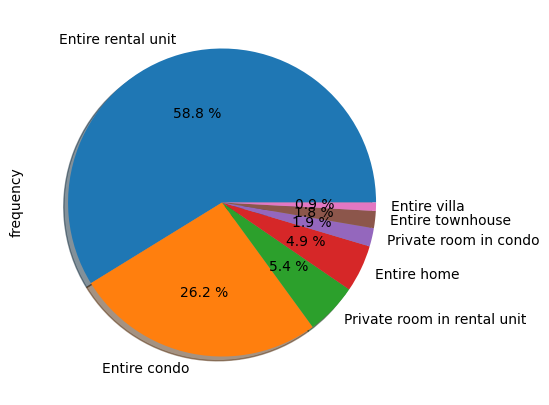

In [109]:
#Realizamos grafico de pastel
table7["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")


In [21]:
table8= freq_tbl(df['room_type'])
table8

,room_type,frequency,percentage,cumulative_perc
0,Entire home/apt,19618,0.911278,0.911278
1,Private room,1879,0.087282,0.998560
2,Shared room,25,0.001161,0.999721
3,Hotel room,6,0.000279,1.000000


In [110]:
table8= table8.drop(['percentage','cumulative_perc'], axis=1)
table8

,room_type,frequency
0,Entire home/apt,19618
1,Private room,1879
2,Shared room,25
3,Hotel room,6


In [111]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table8 = table8[table8['frequency']>5]
table8

,room_type,frequency
0,Entire home/apt,19618
1,Private room,1879
2,Shared room,25
3,Hotel room,6


In [112]:
#Ajusto el índice de mi dataframe
table8 = table8.set_index('room_type')
table8

,frequency
room_type,
Entire home/apt,19618
Private room,1879
Shared room,25
Hotel room,6


Text(0, 0.5, 'Frecuencia')

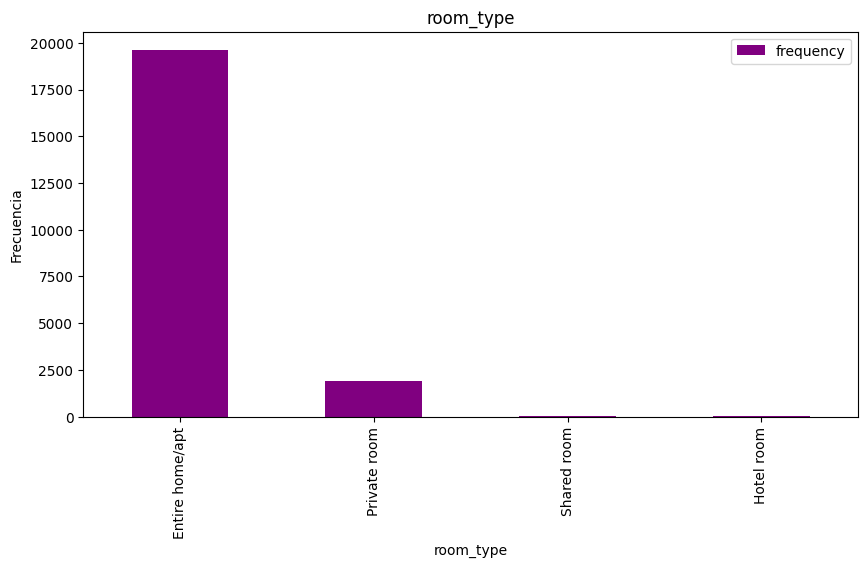

In [114]:
#Realizamos grafico de barras del dataframe filtrado
table8.plot(kind = 'bar', width=0.5, figsize=(10, 5), color="purple")
plt.title('room_type')
plt.ylabel('Frecuencia')


In [22]:
table9= freq_tbl(df['amenities'])
table9

,amenities,frequency,percentage,cumulative_perc
0,"[""TV"", ""Washer"", ""Smoke alarm"", ""Wifi"", ""Kitch...",53,0.002462,0.002462
1,"[""TV"", ""Washer"", ""Wifi"", ""Kitchen"", ""Paid park...",52,0.002415,0.004877
2,"[""Wifi"", ""TV"", ""Kitchen"", ""Washer""]",41,0.001904,0.006782
3,"[""TV"", ""Washer"", ""Smoke alarm"", ""Wifi"", ""Kitch...",31,0.001440,0.008222
4,"[""Wifi"", ""Kitchen"", ""Paid parking on premises""...",26,0.001208,0.009430
...,...,...,...,...
20244,"[""Smoke alarm"", ""Kitchen"", ""Essentials"", ""Refr...",1,0.000046,0.999814
20245,"[""Drying rack for clothing"", ""Smoke alarm"", ""C...",1,0.000046,0.999861
20246,"[""Children\u2019s books and toys for ages 0-2 ...",1,0.000046,0.999907
20247,"[""Essentials"", ""Hangers"", ""Hair dryer"", ""Washe...",1,0.000046,0.999954


<Axes: xlabel='frequency', ylabel='cumulative_perc'>

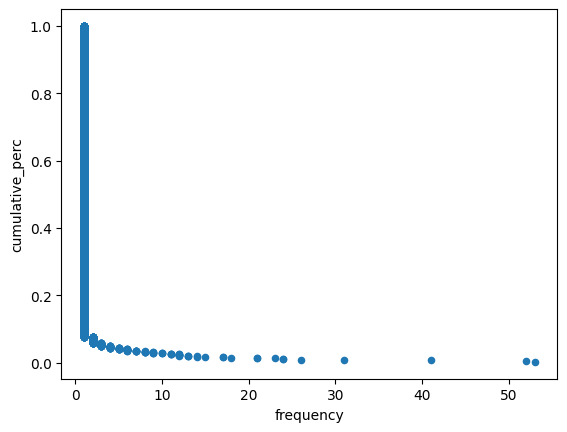

In [115]:
#Realizamos grafico de dispersion del dataframe filtrado
table9.plot("frequency", "cumulative_perc", kind="scatter")

In [23]:
table10= freq_tbl(df['price'])
table10

,price,frequency,percentage,cumulative_perc
0,100,8430,0.391583,0.391583
1,"$1,000.00",599,0.027824,0.419407
2,"$1,200.00",559,0.025966,0.445373
3,"$1,500.00",481,0.022343,0.467716
4,"$1,100.00",434,0.020160,0.487876
...,...,...,...,...
1865,"$1,555.00",1,0.000046,0.999814
1866,"$3,864.00",1,0.000046,0.999861
1867,"$2,456.00",1,0.000046,0.999907
1868,"$2,065.00",1,0.000046,0.999954


In [119]:
table10= table10.drop(['percentage','cumulative_perc'], axis=1)
table10

,price,frequency
0,100,8430
1,"$1,000.00",599
2,"$1,200.00",559
3,"$1,500.00",481
4,"$1,100.00",434
...,...,...
1865,"$1,555.00",1
1866,"$3,864.00",1
1867,"$2,456.00",1
1868,"$2,065.00",1


In [123]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table10 = table10[(table10['frequency'] > 300) & (table10['frequency'] < 8000)]
table10

,price,frequency
1,"$1,000.00",599
2,"$1,200.00",559
3,"$1,500.00",481
4,"$1,100.00",434
5,"$1,300.00",343
6,$900.00,334
7,$800.00,308


In [124]:
#Ajusto el índice de mi dataframe
table10 = table10.set_index('price')
table10

,frequency
price,
"$1,000.00",599
"$1,200.00",559
"$1,500.00",481
"$1,100.00",434
"$1,300.00",343
$900.00,334
$800.00,308


<Axes: ylabel='frequency'>

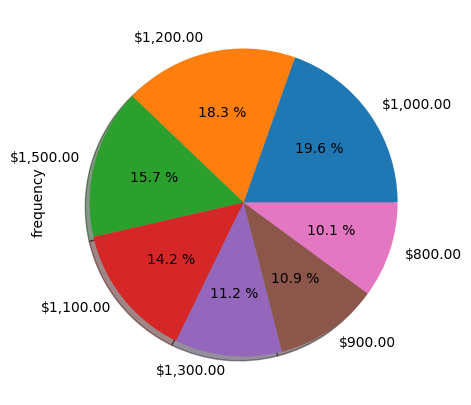

In [126]:
#Realizamos grafico de pastel
table10["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")


In [25]:
table11= freq_tbl(df['has_availability'])
table11

,has_availability,frequency,percentage,cumulative_perc
0,t,21099,0.980072,0.980072
1,f,429,0.019928,1.000000


In [127]:
table11= table11.drop(['percentage','cumulative_perc'], axis=1)
table11

,has_availability,frequency
0,t,21099
1,f,429


In [128]:
#Ajusto el índice de mi dataframe
table11 = table11.set_index('has_availability')
table11

,frequency
has_availability,
t,21099
f,429


Text(0, 0.5, 'Frecuencia')

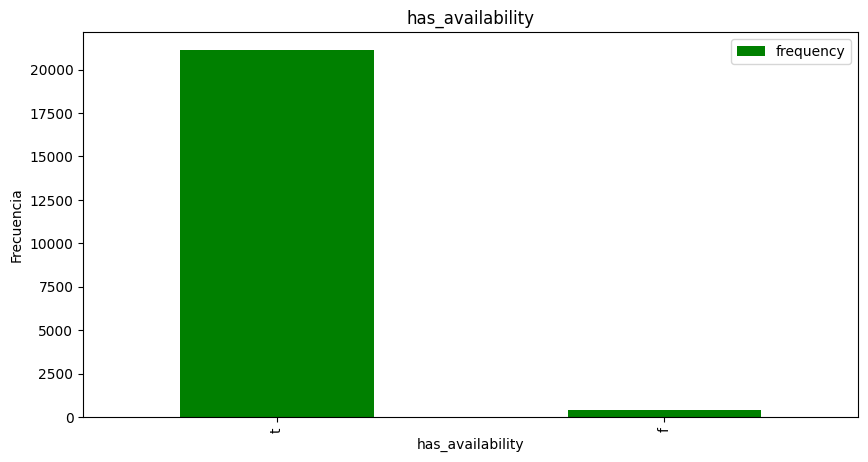

In [130]:
#Realizamos grafico de barras del dataframe filtrado
table11.plot(kind = 'bar', width=0.5, figsize=(10, 5), color="green")
plt.title('has_availability')
plt.ylabel('Frecuencia')


In [24]:
table12= freq_tbl(df['last_review'])
table12

,last_review,frequency,percentage,cumulative_perc
0,2020-00-00,2428,0.112783,0.112783
1,2024-09-22,574,0.026663,0.139446
2,2024-09-15,494,0.022947,0.162393
3,2024-09-16,472,0.021925,0.184318
4,2024-09-01,340,0.015793,0.200111
...,...,...,...,...
1546,2019-10-23,1,0.000046,0.999814
1547,2022-11-23,1,0.000046,0.999861
1548,2021-01-18,1,0.000046,0.999907
1549,2018-07-18,1,0.000046,0.999954


In [131]:
table12= table12.drop(['percentage','cumulative_perc'], axis=1)
table12

,last_review,frequency
0,2020-00-00,2428
1,2024-09-22,574
2,2024-09-15,494
3,2024-09-16,472
4,2024-09-01,340
...,...,...
1546,2019-10-23,1
1547,2022-11-23,1
1548,2021-01-18,1
1549,2018-07-18,1


In [138]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table12 = table12[table12['frequency']>330]
table12

,last_review,frequency
0,2020-00-00,2428
1,2024-09-22,574
2,2024-09-15,494
3,2024-09-16,472
4,2024-09-01,340


In [139]:
#Ajusto el índice de mi dataframe
table12 = table12.set_index('last_review')
table12

,frequency
last_review,
2020-00-00,2428
2024-09-22,574
2024-09-15,494
2024-09-16,472
2024-09-01,340


<Axes: ylabel='frequency'>

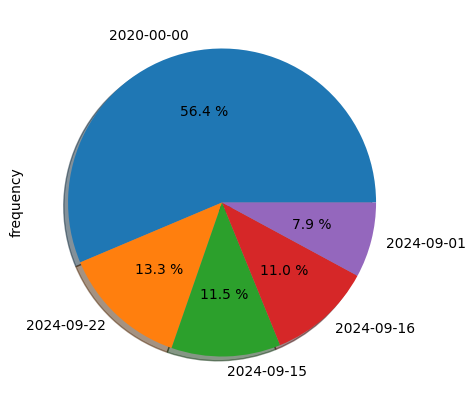

In [140]:

#Realizamos grafico de pastel
table12["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")


In [27]:
df['review_scores_rating'] = df['review_scores_rating'].astype('category')

In [28]:
table13= freq_tbl(df['review_scores_rating'])
table13

,review_scores_rating,frequency,percentage,cumulative_perc
0,5.00,7708,0.358045,0.358045
1,4.92,2836,0.131735,0.489781
2,4.75,563,0.026152,0.515933
3,4.67,541,0.025130,0.541063
4,4.80,519,0.024108,0.565171
...,...,...,...,...
120,4.06,1,0.000046,0.999814
121,4.09,1,0.000046,0.999861
122,4.15,1,0.000046,0.999907
123,4.26,1,0.000046,0.999954


In [142]:
table13= table13.drop(['percentage','cumulative_perc'], axis=1)
table13

,review_scores_rating,frequency
0,5.00,7708
1,4.92,2836
2,4.75,563
3,4.67,541
4,4.80,519
...,...,...
120,4.06,1
121,4.09,1
122,4.15,1
123,4.26,1


In [144]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table13 = table1[table1['frequency']>200]
table13

,frequency
host_acceptance_rate,
67.0,4954
100.0,4749
0.0,1245
50.0,878
75.0,460
99.0,444
80.0,358
33.0,351
60.0,278


Text(0, 0.5, 'Frecuencia')

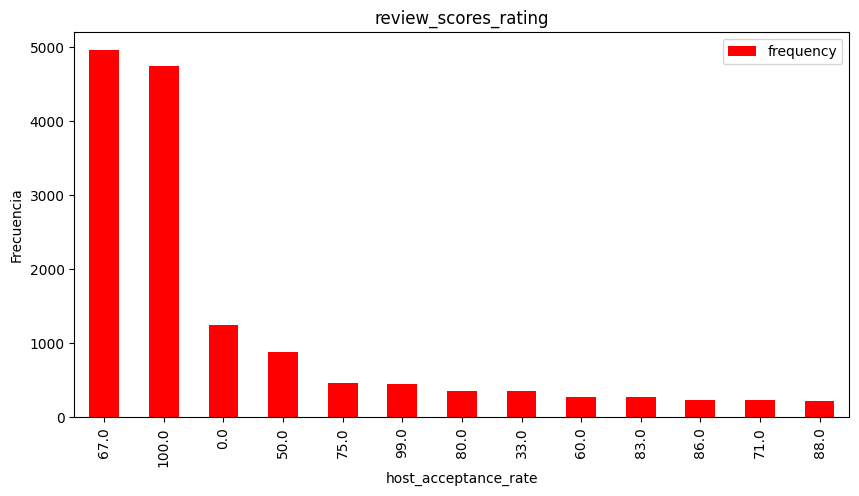

In [146]:
#Realizamos grafico de barras del dataframe filtrado
table13.plot(kind = 'bar', width=0.5, figsize=(10, 5), color="red")
plt.title('review_scores_rating')
plt.ylabel('Frecuencia')


In [30]:
df['review_scores_cleanliness'] = df['review_scores_cleanliness'].astype('category')

In [31]:
table14= freq_tbl(df['review_scores_cleanliness'])
table14

,review_scores_cleanliness,frequency,percentage,cumulative_perc
0,5.00,5583,0.259337,0.259337
1,4.82,2640,0.122631,0.381968
2,4.50,766,0.035582,0.417549
3,4.67,674,0.031308,0.448857
4,4.75,651,0.030240,0.479097
...,...,...,...,...
169,3.27,1,0.000046,0.999814
170,3.47,1,0.000046,0.999861
171,3.44,1,0.000046,0.999907
172,3.39,1,0.000046,0.999954


In [147]:
table14= table14.drop(['percentage','cumulative_perc'], axis=1)
table14

,review_scores_cleanliness,frequency
0,5.00,5583
1,4.82,2640
2,4.50,766
3,4.67,674
4,4.75,651
...,...,...
169,3.27,1
170,3.47,1
171,3.44,1
172,3.39,1


In [157]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table14 = table14[table14['frequency']>400]
table14

,frequency
review_scores_cleanliness,
5.00,5583
4.82,2640
4.50,766
4.67,674
4.75,651
4.00,617
4.80,517
4.83,454


<Axes: ylabel='frequency'>

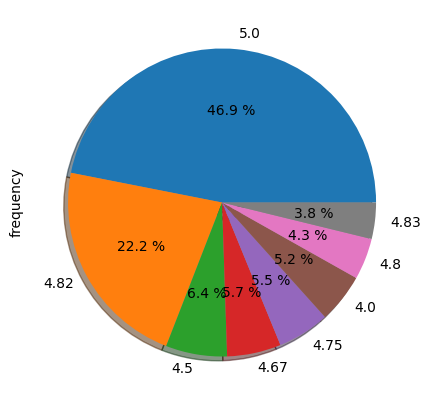

In [158]:
#Realizamos grafico de pastel
table14["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")



In [34]:
df['review_scores_value'] = df['review_scores_value'].astype('category')

In [35]:
table15= freq_tbl(df['review_scores_value'])
table15

,review_scores_value,frequency,percentage,cumulative_perc
0,5.00,4598,0.213582,0.213582
1,4.78,2719,0.126301,0.339883
2,4.67,947,0.043989,0.383872
3,4.50,930,0.043200,0.427072
4,4.75,829,0.038508,0.465580
...,...,...,...,...
134,4.05,1,0.000046,0.999814
135,3.95,1,0.000046,0.999861
136,3.81,1,0.000046,0.999907
137,3.82,1,0.000046,0.999954


<Axes: ylabel='frequency'>

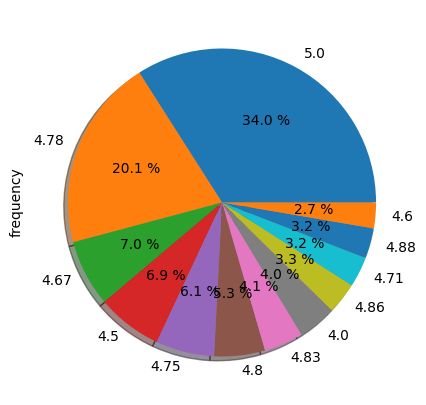

In [164]:
#Realizamos grafico de pastel
table15["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")


In [159]:
table15= table15.drop(['percentage','cumulative_perc'], axis=1)
table15

,review_scores_value,frequency
0,5.00,4598
1,4.78,2719
2,4.67,947
3,4.50,930
4,4.75,829
...,...,...
134,4.05,1
135,3.95,1
136,3.81,1
137,3.82,1


In [161]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table15 = table15[table15['frequency']>350]
table15

,review_scores_value,frequency
0,5.00,4598
1,4.78,2719
2,4.67,947
3,4.50,930
4,4.75,829
5,4.80,720
6,4.83,554
7,4.00,546
8,4.86,446
9,4.71,430


In [162]:
#Ajusto el índice de mi dataframe
table15 = table15.set_index('review_scores_value')
table15

,frequency
review_scores_value,
5.00,4598
4.78,2719
4.67,947
4.50,930
4.75,829
4.80,720
4.83,554
4.00,546
4.86,446


In [33]:
table16= freq_tbl(df['instant_bookable'])
table16

,instant_bookable,frequency,percentage,cumulative_perc
0,f,19544,0.907841,0.907841
1,t,1984,0.092159,1.000000


Text(0, 0.5, 'Frecuencia')

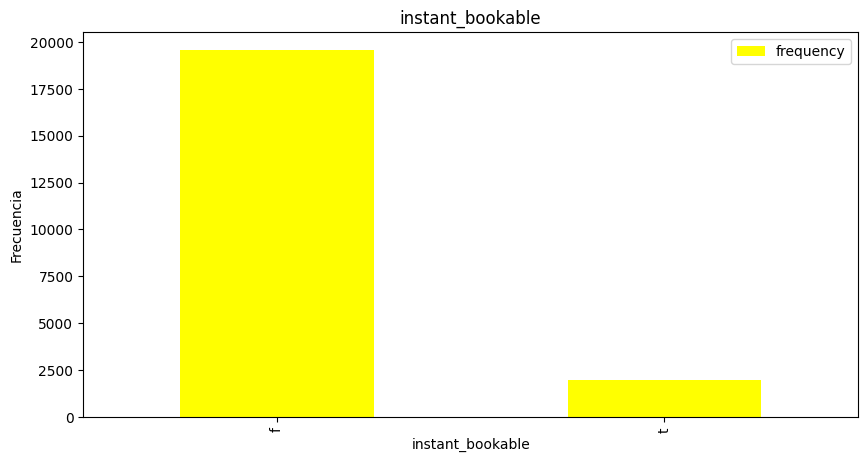

In [168]:
#Realizamos grafico de barras del dataframe filtrado
table16.plot(kind = 'bar', width=0.5, figsize=(10, 5), color="yellow")
plt.title('instant_bookable')
plt.ylabel('Frecuencia')


In [165]:
table16= table16.drop(['percentage','cumulative_perc'], axis=1)
table16

,instant_bookable,frequency
0,f,19544
1,t,1984


In [166]:
#Ajusto el índice de mi dataframe
table16 = table16.set_index('instant_bookable')
table16

,frequency
instant_bookable,
f,19544
t,1984


In [38]:
df['reviews_per_month'] = df['reviews_per_month'].astype('category')

In [39]:
table17= freq_tbl(df['reviews_per_month'])
table17

,reviews_per_month,frequency,percentage,cumulative_perc
0,0.48,2569,0.119333,0.119333
1,0.50,2194,0.101914,0.221247
2,0.07,336,0.015608,0.236854
3,0.11,312,0.014493,0.251347
4,0.08,303,0.014075,0.265422
...,...,...,...,...
189,1.91,11,0.000511,0.998328
190,1.77,10,0.000465,0.998792
191,1.92,10,0.000465,0.999257
192,1.72,9,0.000418,0.999675


<Axes: ylabel='frequency'>

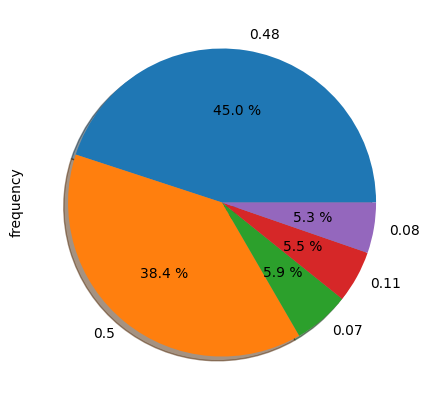

In [172]:
#Realizamos grafico de pastel
table17["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")


In [169]:
table17= table17.drop(['percentage','cumulative_perc'], axis=1)
table1

,frequency
host_acceptance_rate,
67.0,4954
100.0,4749
0.0,1245
50.0,878
75.0,460
99.0,444
80.0,358
33.0,351
60.0,278


In [170]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table17 = table17[table17['frequency']>300]
table17

,reviews_per_month,frequency
0,0.48,2569
1,0.50,2194
2,0.07,336
3,0.11,312
4,0.08,303


In [171]:
#Ajusto el índice de mi dataframe
table17 = table17.set_index('reviews_per_month')
table17

,frequency
reviews_per_month,
0.48,2569
0.50,2194
0.07,336
0.11,312
0.08,303


In [37]:
table18= freq_tbl(df['host_location'])
table18

,host_location,frequency,percentage,cumulative_perc
0,"Copenhagen, Denmark",15495,0.719760,0.719760
1,Copehnague,3452,0.160349,0.880110
2,"Frederiksberg, Denmark",885,0.041109,0.921219
3,Denmark,491,0.022808,0.944026
4,"København, Denmark",197,0.009151,0.953177
...,...,...,...,...
328,"Lakselv, Norway",1,0.000046,0.999814
329,"Raleigh, NC",1,0.000046,0.999861
330,"Gørlev, Denmark",1,0.000046,0.999907
331,"Haderslev, Denmark",1,0.000046,0.999954


Text(0, 0.5, 'Frecuencia')

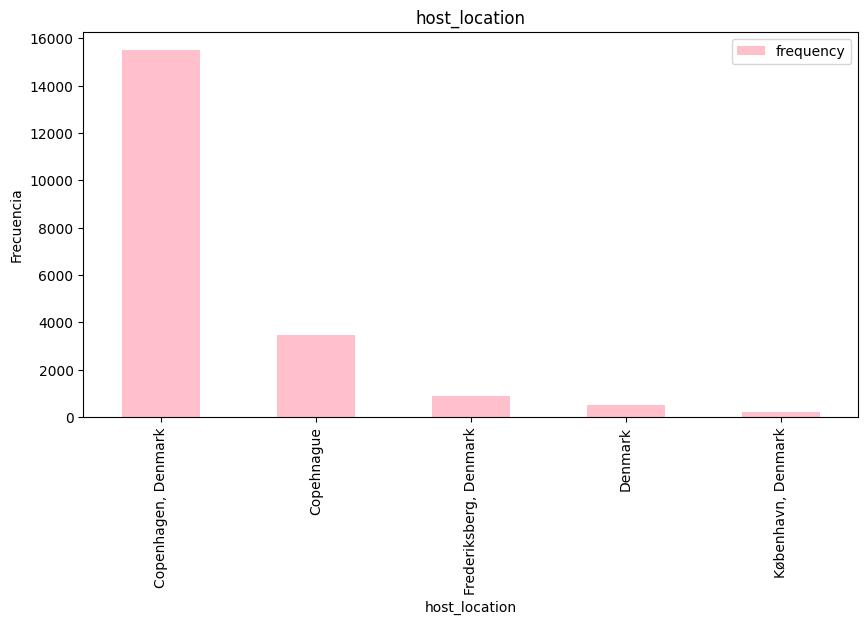

In [177]:
#Realizamos grafico de barras del dataframe filtrado
table18.plot(kind = 'bar', width=0.5, figsize=(10, 5), color="pink")
plt.title('host_location')
plt.ylabel('Frecuencia')


In [173]:
table18= table18.drop(['percentage','cumulative_perc'], axis=1)
table18

,host_location,frequency
0,"Copenhagen, Denmark",15495
1,Copehnague,3452
2,"Frederiksberg, Denmark",885
3,Denmark,491
4,"København, Denmark",197
...,...,...
328,"Lakselv, Norway",1
329,"Raleigh, NC",1
330,"Gørlev, Denmark",1
331,"Haderslev, Denmark",1


In [174]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table18 = table18[table18['frequency']>150]
table18

,host_location,frequency
0,"Copenhagen, Denmark",15495
1,Copehnague,3452
2,"Frederiksberg, Denmark",885
3,Denmark,491
4,"København, Denmark",197


In [175]:
#Ajusto el índice de mi dataframe
table18 = table18.set_index('host_location')
table18

,frequency
host_location,
"Copenhagen, Denmark",15495
Copehnague,3452
"Frederiksberg, Denmark",885
Denmark,491
"København, Denmark",197


In [116]:
df['review_scores_checkin'] = df['review_scores_checkin'].astype('category')

In [117]:
table19= freq_tbl(df['review_scores_checkin'])
table19

,review_scores_checkin,frequency,percentage,cumulative_perc
0,5.00,8929,0.414762,0.414762
1,4.96,2767,0.128530,0.543292
2,4.88,496,0.023040,0.566332
3,4.80,487,0.022622,0.588954
4,4.92,476,0.022111,0.611065
...,...,...,...,...
103,4.31,1,0.000046,0.999814
104,4.37,1,0.000046,0.999861
105,4.39,1,0.000046,0.999907
106,2.33,1,0.000046,0.999954


In [42]:
df['review_scores_checkin'] = df['review_scores_checkin'].astype('category')

<Axes: ylabel='frequency'>

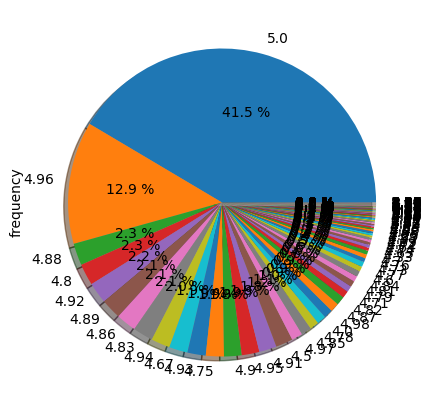

In [194]:
#Realizamos grafico de pastel
table19["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")


In [178]:
table19= table19.drop(['percentage','cumulative_perc'], axis=1)
table19

,review_scores_checkin,frequency
0,5.00,8929
1,4.96,2767
2,4.88,496
3,4.80,487
4,4.92,476
...,...,...
103,4.31,1
104,4.37,1
105,4.39,1
106,2.33,1


In [190]:
#Obtengo un filtro de los valores más reelevantes de las variables categórica seleccionada
table1 = table19[table19['frequency']>450]
table1

,frequency
review_scores_checkin,
5.00,8929
4.96,2767
4.88,496
4.80,487
4.92,476
4.89,459
4.86,456
4.83,453


In [43]:
table20= freq_tbl(df['review_scores_checkin'])
table20

,review_scores_checkin,frequency,percentage,cumulative_perc
0,5.00,8929,0.414762,0.414762
1,4.96,2767,0.128530,0.543292
2,4.88,496,0.023040,0.566332
3,4.80,487,0.022622,0.588954
4,4.92,476,0.022111,0.611065
...,...,...,...,...
103,4.31,1,0.000046,0.999814
104,4.37,1,0.000046,0.999861
105,4.39,1,0.000046,0.999907
106,2.33,1,0.000046,0.999954


In [44]:
table20= table20[table20['frequency']>250]
table20

,review_scores_checkin,frequency,percentage,cumulative_perc
0,5.00,8929,0.414762,0.414762
1,4.96,2767,0.128530,0.543292
2,4.88,496,0.023040,0.566332
3,4.80,487,0.022622,0.588954
4,4.92,476,0.022111,0.611065
5,4.89,459,0.021321,0.632386
6,4.86,456,0.021182,0.653567
7,4.83,453,0.021042,0.674610
8,4.94,427,0.019835,0.694444
9,4.67,418,0.019417,0.713861


In [195]:
#Elimina las columnas "percentage" y "cumulative_perc"
table20= table20.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table20= table20.set_index('review_scores_checkin')
table20

,frequency
review_scores_checkin,
5.00,8929
4.96,2767
4.88,496
4.80,487
4.92,476
4.89,459
4.86,456
4.83,453
4.94,427


Text(0, 0.5, 'Frecuencia')

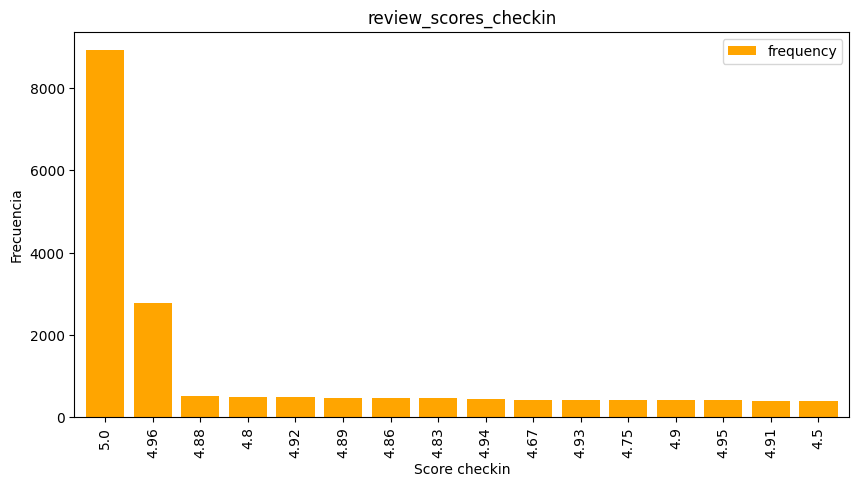

In [196]:
#Personalizamos grafico de barras
table20.plot(kind= 'bar', width=0.8, figsize=(10,5), color="orange")
plt.title('review_scores_checkin')
plt.xlabel('Score checkin')
plt.ylabel('Frecuencia')

In [197]:
df['accommodates'].info()
n=9659

<class 'pandas.core.series.Series'>
RangeIndex: 21528 entries, 0 to 21527
Series name: accommodates
Non-Null Count  Dtype  
--------------  -----  
21528 non-null  float64
dtypes: float64(1)
memory usage: 168.3 KB


In [198]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max= df['accommodates'].max()
Min= df['accommodates'].min()
Limites=[Min, Max]
Limites
#Calcular el Rango R
R= Max-Min
R
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni= 1+3.32*np.log10(n)
ni

14.229974791343807

In [200]:
#Calculamos el Ancho del Intervalo "i"
i= R/ni
i

0.421645160162184

In [199]:
#Categorización de variables
intervalos=np.linspace(Min,Max,15)
intervalos

array([1.        , 1.42857143, 1.85714286, 2.28571429, 2.71428571,
       3.14285714, 3.57142857, 4.        , 4.42857143, 4.85714286,
       5.28571429, 5.71428571, 6.14285714, 6.57142857, 7.        ])

In [201]:
#Creamos las categorías
categorias= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [202]:
#Finalmente creamos las categorías en la columna numérica
df['accommodates']= pd.cut(x=df['accommodates'],bins=intervalos,labels=categorias)
df['accommodates']

,accommodates
0,Categoria3
1,Categorias12
2,Categoria7
3,Categoria7
4,Categorias12
...,...
21523,Categoria7
21524,Categoria7
21525,Categoria5
21526,Categoria3


In [203]:
table21= freq_tbl(df['accommodates'])
table21

,accommodates,frequency,percentage,cumulative_perc
0,Categoria3,9152,0.425121,0.437853
1,Categoria7,5225,0.242707,0.687829
2,Categoria5,2540,0.117986,0.809348
3,Categorias12,1660,0.077109,0.888767
4,Categorias10,1568,0.072835,0.963783
5,Categoria6,498,0.023133,0.987609
6,Categorias14,259,0.012031,1.000000
7,Categoria1,0,0.000000,1.000000
8,Categoria2,0,0.000000,1.000000
9,Categoria4,0,0.000000,1.000000


<Axes: ylabel='frequency'>

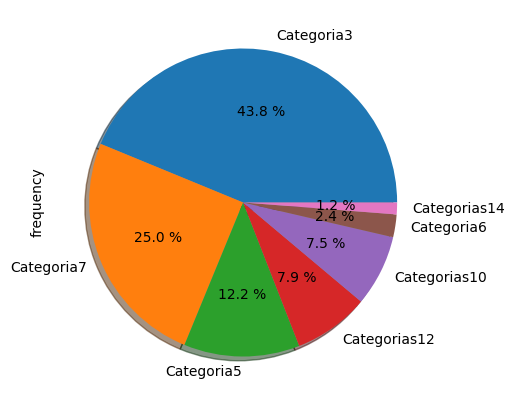

In [204]:
#Elimina las columnas "percentage" y "cumulative_perc"
table21= table21.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table21= table21.set_index('accommodates')
table21= table21[table21['frequency']>31]
#Realizamos grafico de pastel
table21["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [205]:
df['bedrooms'].info()
n=9659

<class 'pandas.core.series.Series'>
RangeIndex: 21528 entries, 0 to 21527
Series name: bedrooms
Non-Null Count  Dtype  
--------------  -----  
21528 non-null  float64
dtypes: float64(1)
memory usage: 168.3 KB


In [206]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max1= df['bedrooms'].max()
Min1= df['bedrooms'].min()
Limites1=[Min1, Max1]
Limites1
#Calcular el Rango R
R1= Max1-Min1
R1
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni1= 1+3.32*np.log10(n)
ni1

14.229974791343807

In [207]:
#Calculamos el Ancho del Intervalo "i"
i1= R1/ni1
i1

0.210822580081092

In [208]:
#Categorización de variables
intervalos1=np.linspace(Min,Max,15)
intervalos1

array([1.        , 1.42857143, 1.85714286, 2.28571429, 2.71428571,
       3.14285714, 3.57142857, 4.        , 4.42857143, 4.85714286,
       5.28571429, 5.71428571, 6.14285714, 6.57142857, 7.        ])

In [209]:
#Creamos las categorías
categorias1= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [210]:
#Finalmente creamos las categorías en la columna numérica
df['bedrooms']= pd.cut(x=df['bedrooms'],bins=intervalos1,labels=categorias1)
df['bedrooms']

,bedrooms
0,NaN
1,Categoria2
2,Categoria3
3,Categoria3
4,Categoria3
...,...
21523,Categoria3
21524,Categoria3
21525,Categoria3
21526,NaN


In [211]:
table22= freq_tbl(df['bedrooms'])
table22

,bedrooms,frequency,percentage,cumulative_perc
0,Categoria3,5279,0.245216,0.613053
1,Categoria5,2475,0.114967,0.900476
2,Categoria2,857,0.039809,1.000000
3,Categoria1,0,0.000000,1.000000
4,Categoria4,0,0.000000,1.000000
5,Categoria6,0,0.000000,1.000000
6,Categoria7,0,0.000000,1.000000
7,Categoria8,0,0.000000,1.000000
8,Categorias9,0,0.000000,1.000000
9,Categorias10,0,0.000000,1.000000


Text(0, 0.5, 'Frecuencia')

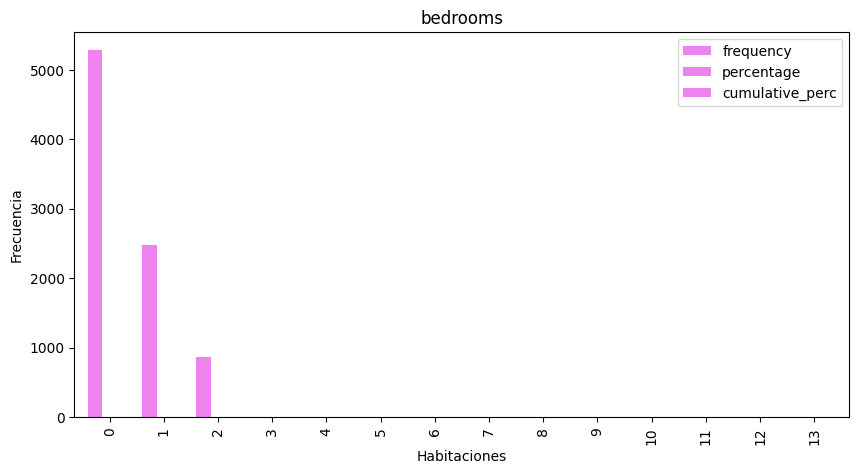

In [212]:
#Elimina las columnas "percentage" y "cumulative_perc"
#table22= table22.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
#table22= table22.set_index('bedrooms')
#table22= table22[table22['frequency']>0]
#Personalizamos grafico de barras
table22.plot(kind= 'bar', width=0.8, figsize=(10,5), color="violet")
plt.title('bedrooms')
plt.xlabel('Habitaciones')
plt.ylabel('Frecuencia')

In [213]:
df['minimum_nights'].info()
n=9659

<class 'pandas.core.series.Series'>
RangeIndex: 21528 entries, 0 to 21527
Series name: minimum_nights
Non-Null Count  Dtype  
--------------  -----  
21528 non-null  float64
dtypes: float64(1)
memory usage: 168.3 KB


In [214]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max2= df['minimum_nights'].max()
Min2= df['minimum_nights'].min()
Limites2=[Min2, Max2]
Limites2
#Calcular el Rango R
R2= Max2-Min2
R2
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni2= 1+3.32*np.log10(n)
ni2

14.229974791343807

In [215]:
#Calculamos el Ancho del Intervalo "i"
i2= R2/ni2
i2

0.421645160162184

In [216]:
#Categorización de variables
intervalos2=np.linspace(Min2,Max2,15)
intervalos2

array([1.        , 1.42857143, 1.85714286, 2.28571429, 2.71428571,
       3.14285714, 3.57142857, 4.        , 4.42857143, 4.85714286,
       5.28571429, 5.71428571, 6.14285714, 6.57142857, 7.        ])

In [217]:
#Creamos las categorías
categorias2= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [218]:
#Finalmente creamos las categorías en la columna numérica
df['minimum_nights']= pd.cut(x=df['minimum_nights'],bins=intervalos2,labels=categorias2)
df['minimum_nights']

,minimum_nights
0,Categoria5
1,Categoria5
2,Categoria5
3,Categoria5
4,Categorias10
...,...
21523,Categorias10
21524,NaN
21525,Categoria7
21526,NaN


In [219]:
table23= freq_tbl(df['minimum_nights'])
table23

,minimum_nights,frequency,percentage,cumulative_perc
0,Categoria5,6359,0.295383,0.353455
1,Categoria3,4985,0.231559,0.630537
2,Categoria7,2936,0.136381,0.793730
3,Categorias10,2247,0.104376,0.918626
4,Categorias14,801,0.037207,0.963148
5,Categorias12,663,0.030797,1.000000
6,Categoria1,0,0.000000,1.000000
7,Categoria2,0,0.000000,1.000000
8,Categoria4,0,0.000000,1.000000
9,Categoria6,0,0.000000,1.000000


<Axes: ylabel='frequency'>

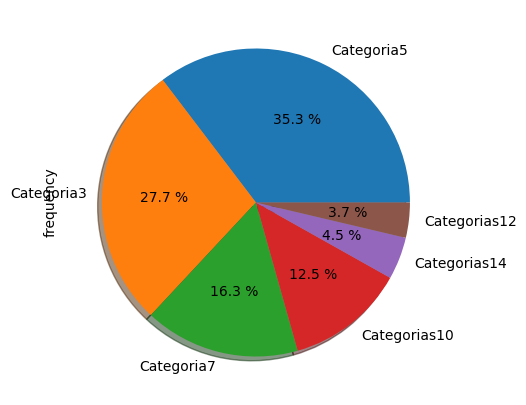

In [220]:
#Elimina las columnas "percentage" y "cumulative_perc"
table23= table23.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table23= table23.set_index('minimum_nights')
table23= table23[table23['frequency']>180]
#Realizamos grafico de pastel
table23["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [221]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max3= df['maximum_nights'].max()
Min3= df['maximum_nights'].min()
Limites3=[Min3, Max3]
Limites3
#Calcular el Rango R
R3= Max3-Min3
R3
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni3= 1+3.32*np.log10(n)
ni3

14.229974791343807

In [222]:
#Calculamos el Ancho del Intervalo "i"
i3= R3/ni3
i3

56.149080494930836

In [223]:
#Categorización de variables
intervalos3=np.linspace(Min3,Max3,15)
intervalos3

array([  1.        ,  58.07142857, 115.14285714, 172.21428571,
       229.28571429, 286.35714286, 343.42857143, 400.5       ,
       457.57142857, 514.64285714, 571.71428571, 628.78571429,
       685.85714286, 742.92857143, 800.        ])

In [224]:
#Creamos las categorías
categorias3= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [225]:
#Finalmente creamos las categorías en la columna numérica
df['maximum_nights']= pd.cut(x=df['maximum_nights'],bins=intervalos3,labels=categorias3)
df['maximum_nights']

,maximum_nights
0,Categoria3
1,Categoria1
2,Categoria1
3,Categoria3
4,Categoria3
...,...
21523,Categoria1
21524,Categoria1
21525,Categoria7
21526,Categoria7


In [226]:
table24= freq_tbl(df['maximum_nights'])
table24

,maximum_nights,frequency,percentage,cumulative_perc
0,Categoria1,9410,0.437105,0.437410
1,Categoria7,6492,0.301561,0.739181
2,Categoria3,3942,0.183110,0.922419
3,Categoria2,1081,0.050214,0.972668
4,Categorias13,390,0.018116,0.990796
5,Categoria4,95,0.004413,0.995212
6,Categoria6,62,0.002880,0.998094
7,Categorias9,16,0.000743,0.998838
8,Categoria5,15,0.000697,0.999535
9,Categorias11,7,0.000325,0.999861


Text(0, 0.5, 'Frecuencia')

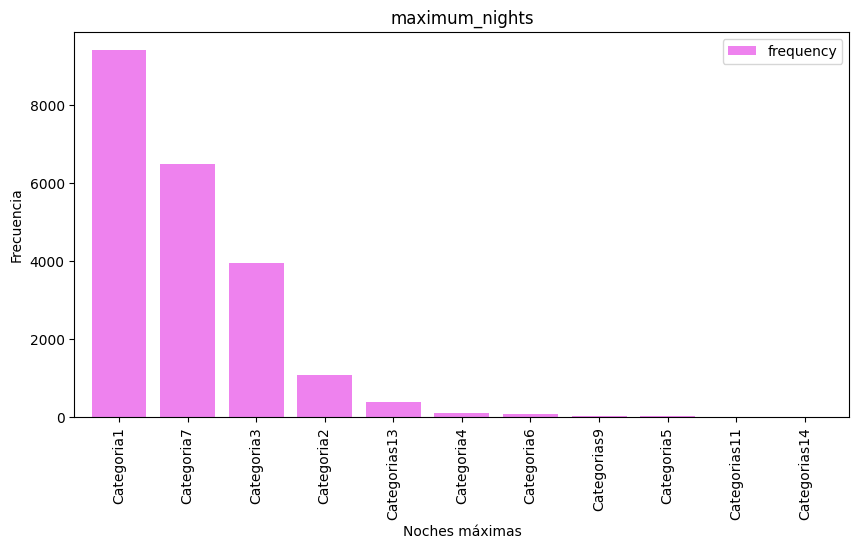

In [227]:
#Elimina las columnas "percentage" y "cumulative_perc"
table24= table24.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table24= table24.set_index('maximum_nights')
table24= table24[table24['frequency']>0]
#Personalizamos grafico de barras
table24.plot(kind= 'bar', width=0.8, figsize=(10,5), color="violet")
plt.title('maximum_nights')
plt.xlabel('Noches máximas')
plt.ylabel('Frecuencia')

In [229]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max4= df['minimum_minimum_nights'].max()
Min4= df['minimum_minimum_nights'].min()
Limites4=[Min4, Max4]
Limites4
#Calcular el Rango R
R4= Max4-Min4
R4
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni4= 1+3.32*np.log10(n)
ni4

14.229974791343807

In [230]:
#Calculamos el Ancho del Intervalo "i"
i4= R4/ni4
i4

0.421645160162184

In [231]:
#Categorización de variables
intervalos4=np.linspace(Min4,Max4,15)
intervalos4

array([1.        , 1.42857143, 1.85714286, 2.28571429, 2.71428571,
       3.14285714, 3.57142857, 4.        , 4.42857143, 4.85714286,
       5.28571429, 5.71428571, 6.14285714, 6.57142857, 7.        ])

In [232]:
#Creamos las categorías
categorias4= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [233]:
#Finalmente creamos las categorías en la columna numérica
df['minimum_minimum_nights']= pd.cut(x=df['minimum_minimum_nights'],bins=intervalos4,labels=categorias4)
df['minimum_minimum_nights']

,minimum_minimum_nights
0,Categoria5
1,Categoria5
2,Categoria5
3,Categoria5
4,Categorias14
...,...
21523,Categorias10
21524,NaN
21525,Categoria7
21526,NaN


In [234]:
table25= freq_tbl(df['minimum_minimum_nights'])
table25

,minimum_minimum_nights,frequency,percentage,cumulative_perc
0,Categoria5,5870,0.272668,0.341816
1,Categoria3,5242,0.243497,0.647062
2,Categoria7,2705,0.125650,0.804577
3,Categorias10,2032,0.094389,0.922902
4,Categorias14,736,0.034188,0.965760
5,Categorias12,588,0.027313,1.000000
6,Categoria1,0,0.000000,1.000000
7,Categoria2,0,0.000000,1.000000
8,Categoria4,0,0.000000,1.000000
9,Categoria6,0,0.000000,1.000000


<Axes: ylabel='frequency'>

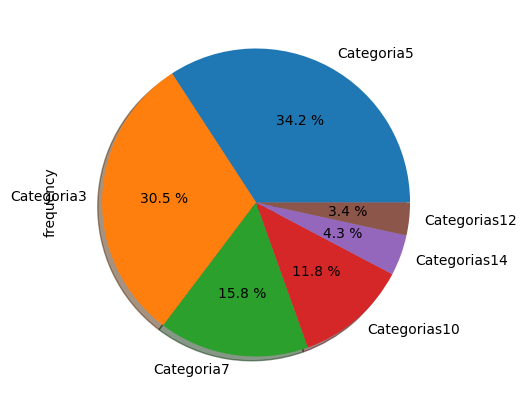

In [285]:
#Elimina las columnas "percentage" y "cumulative_perc"
table25= table25.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table25= table25.set_index('minimum_minimum_nights')
table25= table25[table25['frequency']>180]
#Realizamos grafico de pastel
table25["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [235]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max5= df['maximum_minimum_nights'].max()
Min5= df['maximum_minimum_nights'].min()
Limites5=[Min5, Max5]
Limites5
#Calcular el Rango R
R5= Max5-Min5
R5
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni5= 1+3.32*np.log10(n)
ni5

14.229974791343807

In [236]:
#Calculamos el Ancho del Intervalo "i"
i5= R5/ni5
i5

0.421645160162184

In [237]:
#Categorización de variables
intervalos5=np.linspace(Min5,Max5,15)
intervalos5

array([1.        , 1.42857143, 1.85714286, 2.28571429, 2.71428571,
       3.14285714, 3.57142857, 4.        , 4.42857143, 4.85714286,
       5.28571429, 5.71428571, 6.14285714, 6.57142857, 7.        ])

In [238]:
#Creamos las categorías
categorias5= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [239]:
#Finalmente creamos las categorías en la columna numérica
df['maximum_minimum_nights']= pd.cut(x=df['maximum_minimum_nights'],bins=intervalos5,labels=categorias5)
df['maximum_minimum_nights']

,maximum_minimum_nights
0,Categoria5
1,Categoria5
2,Categoria5
3,Categoria6
4,Categoria6
...,...
21523,Categorias10
21524,NaN
21525,Categoria7
21526,NaN


In [240]:
table26= freq_tbl(df['maximum_minimum_nights'])
table26

,maximum_minimum_nights,frequency,percentage,cumulative_perc
0,Categoria5,5450,0.253159,0.292586
1,Categoria3,4728,0.219621,0.546411
2,Categoria7,3183,0.147854,0.717292
3,Categorias10,2442,0.113434,0.848392
4,Categoria6,1159,0.053837,0.910614
5,Categorias14,924,0.042921,0.960219
6,Categorias12,741,0.034420,1.000000
7,Categoria1,0,0.000000,1.000000
8,Categoria2,0,0.000000,1.000000
9,Categoria4,0,0.000000,1.000000


Text(0, 0.5, 'Frecuencia')

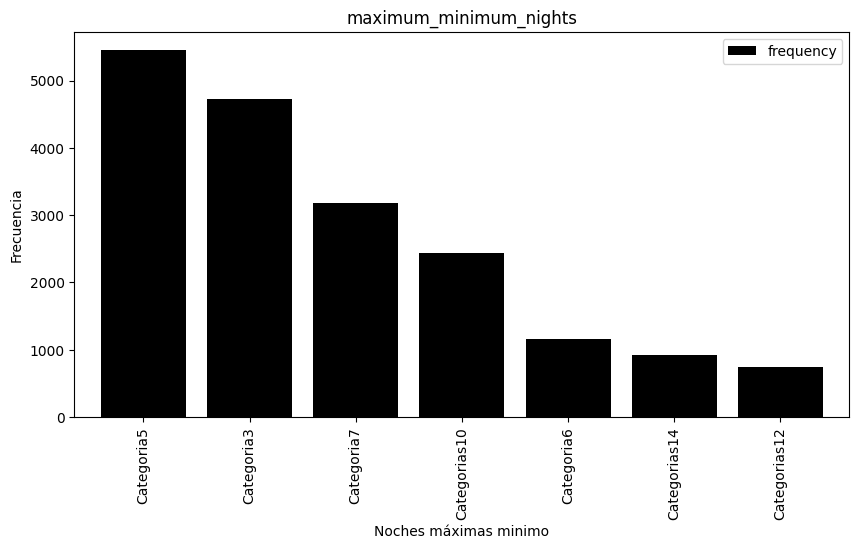

In [287]:
#Elimina las columnas "percentage" y "cumulative_perc"
table26= table26.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table26= table26.set_index('maximum_minimum_nights')
table26= table26[table26['frequency']>232]
#Personalizamos grafico de barras
table26.plot(kind= 'bar', width=0.8, figsize=(10,5), color="black")
plt.title('maximum_minimum_nights')
plt.xlabel('Noches máximas minimo')
plt.ylabel('Frecuencia')

In [241]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max6= df['minimum_maximum_nights'].max()
Min6= df['minimum_maximum_nights'].min()
Limites6=[Min6, Max6]
Limites6
#Calcular el Rango R
R6= Max6-Min6
R6
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni6= 1+3.32*np.log10(n)
ni6

14.229974791343807

In [242]:
#Calculamos el Ancho del Intervalo "i"
i6= R6/ni6
i6

78.98819333704913

In [243]:
#Categorización de variables
intervalos6=np.linspace(Min6,Max6,15)
intervalos6

array([1.00000000e+00, 8.12857143e+01, 1.61571429e+02, 2.41857143e+02,
       3.22142857e+02, 4.02428571e+02, 4.82714286e+02, 5.63000000e+02,
       6.43285714e+02, 7.23571429e+02, 8.03857143e+02, 8.84142857e+02,
       9.64428571e+02, 1.04471429e+03, 1.12500000e+03])

In [244]:
#Creamos las categorías
categorias6= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [245]:
#Finalmente creamos las categorías en la columna numérica
df['minimum_maximum_nights']= pd.cut(x=df['minimum_maximum_nights'],bins=intervalos6,labels=categorias6)
df['minimum_maximum_nights']

,minimum_maximum_nights
0,Categorias14
1,Categoria1
2,Categoria1
3,Categorias14
4,Categorias14
...,...
21523,Categoria1
21524,Categoria1
21525,Categoria5
21526,Categoria5


In [246]:
table27= freq_tbl(df['minimum_maximum_nights'])
table27

,minimum_maximum_nights,frequency,percentage,cumulative_perc
0,Categoria1,9177,0.426282,0.426559
1,Categoria5,6014,0.279357,0.706098
2,Categorias14,5226,0.242754,0.949010
3,Categoria2,518,0.024062,0.973087
4,Categorias10,329,0.015282,0.988380
5,Categoria3,112,0.005203,0.993586
6,Categorias9,42,0.001951,0.995538
7,Categoria4,39,0.001812,0.997351
8,Categorias13,33,0.001533,0.998884
9,Categoria7,15,0.000697,0.999582


<Axes: ylabel='frequency'>

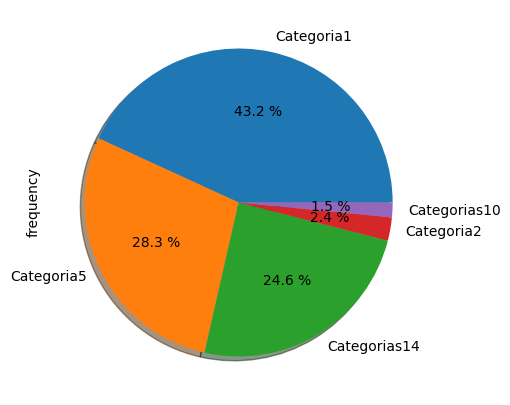

In [288]:
#Elimina las columnas "percentage" y "cumulative_perc"
table27= table27.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table27= table27.set_index('minimum_maximum_nights')
table27= table27[table27['frequency']>180]
#Realizamos grafico de pastel
table27["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [247]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max7= df['maximum_maximum_nights'].max()
Min7= df['maximum_maximum_nights'].min()
Limites7=[Min7, Max7]
Limites7
#Calcular el Rango R
R7= Max7-Min7
R7
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni7= 1+3.32*np.log10(n)
ni7

14.229974791343807

In [248]:
#Calculamos el Ancho del Intervalo "i"
i7= R7/ni7
i7

78.98819333704913

In [249]:
#Categorización de variables
intervalos7=np.linspace(Min7,Max7,15)
intervalos7

array([1.00000000e+00, 8.12857143e+01, 1.61571429e+02, 2.41857143e+02,
       3.22142857e+02, 4.02428571e+02, 4.82714286e+02, 5.63000000e+02,
       6.43285714e+02, 7.23571429e+02, 8.03857143e+02, 8.84142857e+02,
       9.64428571e+02, 1.04471429e+03, 1.12500000e+03])

In [251]:
#Creamos las categorías
categorias7= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [252]:
#Finalmente creamos las categorías en la columna numérica
df['maximum_maximum_nights']= pd.cut(x=df['maximum_maximum_nights'],bins=intervalos7,labels=categorias7)
df['maximum_maximum_nights']

,maximum_maximum_nights
0,Categorias14
1,Categoria1
2,Categoria1
3,Categorias14
4,Categorias14
...,...
21523,Categoria1
21524,Categoria1
21525,Categoria5
21526,Categoria5


In [253]:
table28= freq_tbl(df['maximum_maximum_nights'])
table28

,maximum_maximum_nights,frequency,percentage,cumulative_perc
0,Categoria1,8904,0.413601,0.413851
1,Categoria5,6029,0.280054,0.694074
2,Categorias14,5467,0.253948,0.948176
3,Categoria2,531,0.024666,0.972856
4,Categorias10,332,0.015422,0.988287
5,Categoria3,115,0.005342,0.993632
6,Categorias9,42,0.001951,0.995584
7,Categoria4,37,0.001719,0.997304
8,Categorias13,33,0.001533,0.998838
9,Categoria7,16,0.000743,0.999582


Text(0, 0.5, 'Frecuencia')

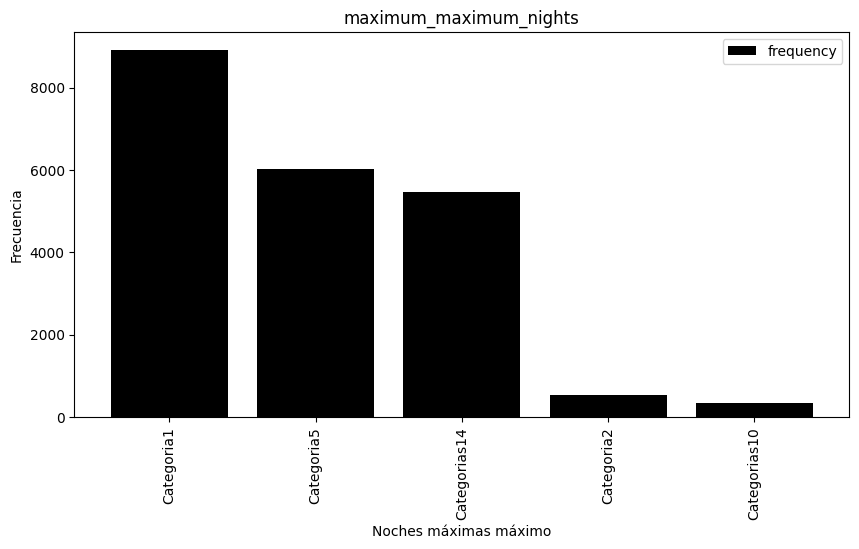

In [289]:
#Elimina las columnas "percentage" y "cumulative_perc"
table28= table28.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table28= table28.set_index('maximum_maximum_nights')
table28= table28[table28['frequency']>201]
#Personalizamos grafico de barras
table28.plot(kind= 'bar', width=0.8, figsize=(10,5), color="black")
plt.title('maximum_maximum_nights')
plt.xlabel('Noches máximas máximo')
plt.ylabel('Frecuencia')

In [254]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max8= df['minimum_nights_avg_ntm'].max()
Min8= df['minimum_nights_avg_ntm'].min()
Limites8=[Min8, Max8]
Limites8
#Calcular el Rango R
R8= Max8-Min8
R8
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni8= 1+3.32*np.log10(n)
ni8

14.229974791343807

In [255]:
#Calculamos el Ancho del Intervalo "i"
i8= R8/ni8
i8

0.421645160162184

In [256]:
#Categorización de variables
intervalos8=np.linspace(Min8,Max8,15)
intervalos8

array([1.        , 1.42857143, 1.85714286, 2.28571429, 2.71428571,
       3.14285714, 3.57142857, 4.        , 4.42857143, 4.85714286,
       5.28571429, 5.71428571, 6.14285714, 6.57142857, 7.        ])

In [257]:
#Creamos las categorías
categorias8= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [258]:
#Finalmente creamos las categorías en la columna numérica
df['minimum_nights_avg_ntm']= pd.cut(x=df['minimum_nights_avg_ntm'],bins=intervalos8,labels=categorias8)
df['minimum_nights_avg_ntm']

,minimum_nights_avg_ntm
0,Categoria5
1,Categoria5
2,Categoria5
3,Categoria5
4,Categoria5
...,...
21523,Categorias10
21524,NaN
21525,Categoria7
21526,NaN


In [259]:
table29= freq_tbl(df['minimum_nights_avg_ntm'])
table29

,minimum_nights_avg_ntm,frequency,percentage,cumulative_perc
0,Categoria5,6310,0.293107,0.339667
1,Categoria3,4896,0.227425,0.603219
2,Categoria7,2914,0.135359,0.760080
3,Categorias10,2198,0.102100,0.878398
4,Categorias14,786,0.036511,0.920708
5,Categorias12,667,0.030983,0.956613
6,Categoria1,315,0.014632,0.973569
7,Categoria4,162,0.007525,0.982290
8,Categoria6,87,0.004041,0.986973
9,Categoria8,79,0.003670,0.991226


<Axes: ylabel='frequency'>

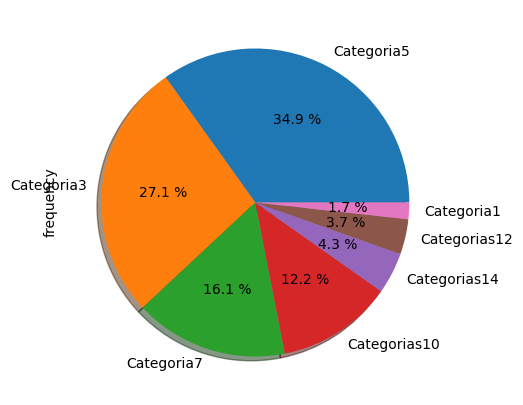

In [290]:
#Elimina las columnas "percentage" y "cumulative_perc"
table29= table29.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table29= table29.set_index('minimum_nights_avg_ntm')
table29= table29[table29['frequency']>294]
#Realizamos grafico de pastel
table29["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [260]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max9= df['availability_30'].max()
Min9= df['availability_30'].min()
Limites9=[Min9, Max9]
Limites9
#Calcular el Rango R
R9= Max9-Min9
R9
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni9= 1+3.32*np.log10(n)
ni9

14.229974791343807

In [261]:
#Calculamos el Ancho del Intervalo "i"
i9= R9/ni9
i9

1.40548386720728

In [262]:
#Categorización de variables
intervalos9=np.linspace(Min9,Max9,15)
intervalos9

array([ 0.        ,  1.42857143,  2.85714286,  4.28571429,  5.71428571,
        7.14285714,  8.57142857, 10.        , 11.42857143, 12.85714286,
       14.28571429, 15.71428571, 17.14285714, 18.57142857, 20.        ])

In [263]:
#Creamos las categorías
categorias9= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [264]:
#Finalmente creamos las categorías en la columna numérica
df['availability_30']= pd.cut(x=df['availability_30'],bins=intervalos9,labels=categorias9)
df['availability_30']

,availability_30
0,NaN
1,NaN
2,NaN
3,NaN
4,NaN
...,...
21523,Categorias12
21524,Categoria2
21525,Categoria2
21526,Categoria2


In [265]:
table30= freq_tbl(df['availability_30'])
table30

,availability_30,frequency,percentage,cumulative_perc
0,Categoria2,3421,0.158909,0.364285
1,Categoria3,991,0.046033,0.469812
2,Categoria5,844,0.039205,0.559685
3,Categoria7,755,0.035071,0.640081
4,Categoria1,739,0.034327,0.718773
5,Categoria6,482,0.022389,0.770099
6,Categorias10,400,0.018580,0.812693
7,Categoria4,368,0.017094,0.851879
8,Categorias12,326,0.015143,0.886594
9,Categorias14,290,0.013471,0.917474


Text(0, 0.5, 'Frecuencia')

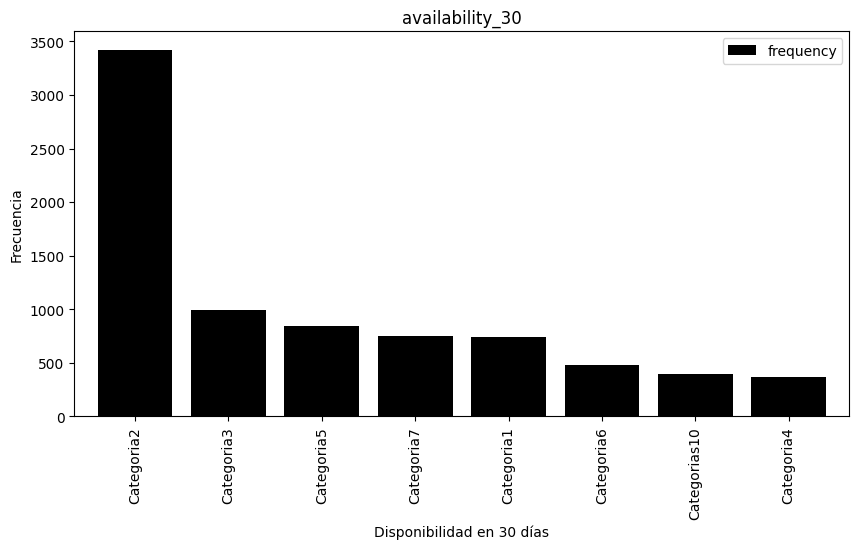

In [291]:
#Elimina las columnas "percentage" y "cumulative_perc"
table30= table30.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table30= table30.set_index('availability_30')
table30= table30[table30['frequency']>353]
#Personalizamos grafico de barras
table30.plot(kind= 'bar', width=0.8, figsize=(10,5), color="black")
plt.title('availability_30')
plt.xlabel('Disponibilidad en 30 días')
plt.ylabel('Frecuencia')

In [266]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max10= df['availability_60'].max()
Min10= df['availability_60'].min()
Limites10=[Min10, Max10]
Limites10
#Calcular el Rango R
R10= Max10-Min10
R10
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni10= 1+3.32*np.log10(n)
ni10

14.229974791343807

In [267]:
#Calculamos el Ancho del Intervalo "i"
i10= R10/ni10
i10

3.6542580547389276

In [268]:
#Categorización de variables
intervalos10=np.linspace(Min10,Max10,15)
intervalos10

array([ 0.        ,  3.71428571,  7.42857143, 11.14285714, 14.85714286,
       18.57142857, 22.28571429, 26.        , 29.71428571, 33.42857143,
       37.14285714, 40.85714286, 44.57142857, 48.28571429, 52.        ])

In [269]:
#Creamos las categorías
categorias10= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [270]:
#Finalmente creamos las categorías en la columna numérica
df['availability_60']= pd.cut(x=df['availability_60'],bins=intervalos10,labels=categorias10)
df['availability_60']

,availability_60
0,NaN
1,NaN
2,NaN
3,NaN
4,NaN
...,...
21523,Categorias13
21524,Categoria3
21525,Categoria3
21526,Categoria3


In [271]:
table31= freq_tbl(df['availability_60'])
table31

,availability_60,frequency,percentage,cumulative_perc
0,Categoria3,3406,0.158213,0.326621
1,Categoria1,1534,0.071256,0.473725
2,Categoria2,1338,0.062152,0.602033
3,Categoria7,573,0.026616,0.656981
4,Categoria5,436,0.020253,0.698792
5,Categoria4,404,0.018766,0.737534
6,Categorias9,389,0.018069,0.774837
7,Categorias14,388,0.018023,0.812044
8,Categoria6,370,0.017187,0.847526
9,Categorias13,361,0.016769,0.882144


<Axes: ylabel='frequency'>

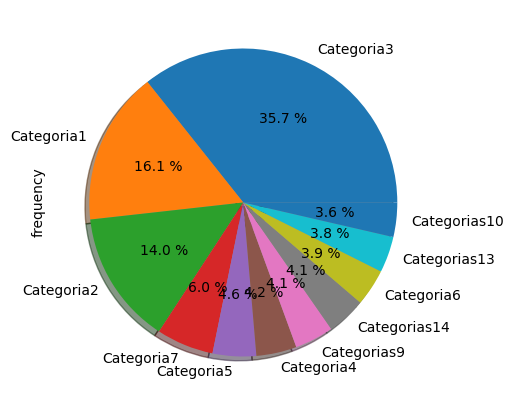

In [292]:
#Elimina las columnas "percentage" y "cumulative_perc"
table31= table31.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table31= table31.set_index('availability_60')
table31= table31[table31['frequency']>334]
#Realizamos grafico de pastel
table31["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [272]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max11= df['availability_90'].max()
Min11= df['availability_90'].min()
Limites11=[Min11, Max11]
Limites11
#Calcular el Rango R
R11= Max11-Min11
R11
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni11= 1+3.32*np.log10(n)
ni11

14.229974791343807

In [273]:
#Calculamos el Ancho del Intervalo "i"
i11= R11/ni11
i11

6.1138548223516676

In [274]:
#Categorización de variables
intervalos11=np.linspace(Min11,Max11,15)
intervalos11

array([ 0.        ,  6.21428571, 12.42857143, 18.64285714, 24.85714286,
       31.07142857, 37.28571429, 43.5       , 49.71428571, 55.92857143,
       62.14285714, 68.35714286, 74.57142857, 80.78571429, 87.        ])

In [275]:
#Creamos las categorías
categorias11= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [276]:
#Finalmente creamos las categorías en la columna numérica
df['availability_90']= pd.cut(x=df['availability_90'],bins=intervalos11,labels=categorias11)
df['availability_90']

,availability_90
0,NaN
1,NaN
2,NaN
3,NaN
4,NaN
...,...
21523,Categorias13
21524,Categoria3
21525,Categoria3
21526,Categoria3


In [277]:
table32= freq_tbl(df['availability_90'])
table32

,availability_90,frequency,percentage,cumulative_perc
0,Categoria1,2325,0.107999,0.203288
1,Categoria3,1893,0.087932,0.368803
2,Categoria2,1584,0.073579,0.507301
3,Categorias14,1161,0.053930,0.608814
4,Categoria5,645,0.029961,0.665209
5,Categorias10,594,0.027592,0.717146
6,Categoria4,491,0.022808,0.760077
7,Categorias13,465,0.021600,0.800734
8,Categorias12,413,0.019184,0.836845
9,Categoria6,410,0.019045,0.872694


Text(0, 0.5, 'Frecuencia')

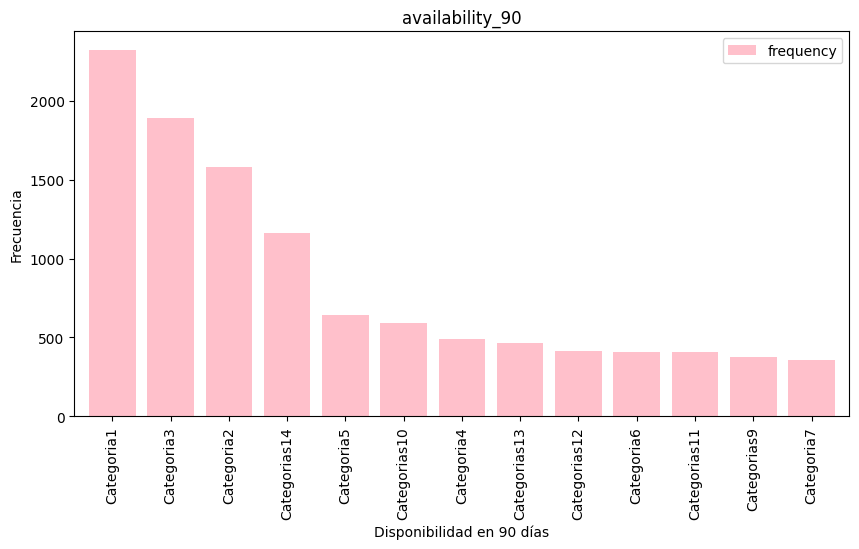

In [293]:
#Elimina las columnas "percentage" y "cumulative_perc"
table32= table32.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table32= table32.set_index('availability_90')
table32= table32[table32['frequency']>357]
#Personalizamos grafico de barras
table32.plot(kind= 'bar', width=0.8, figsize=(10,5), color="pink")
plt.title('availability_90')
plt.xlabel('Disponibilidad en 90 días')
plt.ylabel('Frecuencia')

In [278]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max12= df['number_of_reviews_ltm'].max()
Min12= df['number_of_reviews_ltm'].min()
Limites12=[Min12, Max12]
Limites12
#Calcular el Rango R
R12= Max12-Min12
R12
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni12= 1+3.32*np.log10(n)
ni12

14.229974791343807

In [279]:
#Calculamos el Ancho del Intervalo "i"
i12= R12/ni12
i12

1.05411290040546

In [280]:
#Categorización de variables
intervalos12=np.linspace(Min12,Max12,15)
intervalos12

array([ 0.        ,  1.07142857,  2.14285714,  3.21428571,  4.28571429,
        5.35714286,  6.42857143,  7.5       ,  8.57142857,  9.64285714,
       10.71428571, 11.78571429, 12.85714286, 13.92857143, 15.        ])

In [281]:
#Creamos las categorías
categorias12= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [ ]:
#Finalmente creamos las categorías en la columna numérica
df['number_of_reviews_ltm']= pd.cut(x=df['number_of_reviews_ltm'],bins=intervalos12,labels=categorias12)
df['number_of_reviews_ltm']

,number_of_reviews_ltm
0,NaN
1,NaN
2,Categoria7
3,NaN
4,Categoria3
...,...
9654,NaN
9655,NaN
9656,Categoria5
9657,NaN


In [283]:
df['number_of_reviews_ltm'] = df['number_of_reviews_ltm'].astype('category')

In [299]:
table33= freq_tbl(df['number_of_reviews_ltm'])
table33

,number_of_reviews_ltm,frequency,percentage,cumulative_perc
0,0.0,7054,0.327666,0.327666
1,1.0,2232,0.103679,0.431345
2,2.0,1990,0.092438,0.523783
3,3.0,1708,0.079339,0.603122
4,3.1,1605,0.074554,0.677676
5,4.0,1359,0.063127,0.740803
6,5.0,1146,0.053233,0.794036
7,6.0,943,0.043803,0.837839
8,7.0,747,0.034699,0.872538
9,8.0,605,0.028103,0.900641


<Axes: ylabel='frequency'>

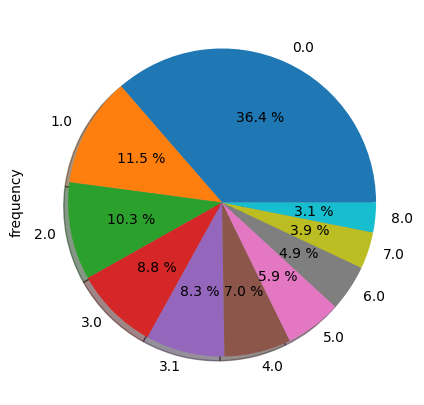

In [300]:
#Elimina las columnas "percentage" y "cumulative_perc"
table33= table33.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table33= table33.set_index('number_of_reviews_ltm')
table33= table33[table33['frequency']>595]
#Realizamos grafico de pastel
table33["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")